**Assignment 2 AML**

**Mohit (20D070052)**

**Que 1. Download labeled faces in the wild (LFW) dataset:** http://vis-www.cs.umass.edu/lfw/

In [1]:
from matplotlib import pyplot as plt        # Importing from matplotlib to make histogram plots
import numpy as np                          # Importing Numpy mainly for arrays in this assignment
import cv2                                  # Importing CV2 to use openCV
from google.colab.patches import cv2_imshow # Importing cv2_imshow to show the image
import os
import random
import pandas as pd
import seaborn as sns; sns.set()

# Importing the required libraries
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model, Sequential
from keras.metrics import Sum
import glob
from keras.optimizers import Adam
from sklearn.metrics import accuracy_score

from tensorflow.keras.layers import Layer
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2

from tensorflow.keras.layers import Input, Lambda, GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras import backend as K

import torch
import torch.nn as nn


In [2]:
from google.colab import drive                            # Mounting the drive to load the dataset
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Now loading the dataset into colab

Reference : https://faun.pub/how-to-load-datasets-on-google-colab-517514f6aac4

In [6]:
import requests

# LFW with the actual URL of the dataset file we want to download.
dataset_url = "https://vis-www.cs.umass.edu/lfw/lfw.tgz"
response = requests.get(dataset_url)

# Checking the response from the server and then download
if response.status_code == 200:
    with open('dataset.tgz', 'wb') as file:
        file.write(response.content)
    print("Dataset downloaded successfully.")
else:
    print("Failed to download dataset. Check the URL or your internet connection.")

In [ ]:
import tarfile

# Naming of .tgz file.
tgz_file = "dataset.tgz"

In [ ]:
# Create output directories
os.makedirs(os.path.join('/content/drive/MyDrive/AML_ASSIGNMENT_2', 'Data'), exist_ok=True)

In [ ]:
# Open and extract the .tgz file into the created directory
with tarfile.open(tgz_file, 'r:gz') as tar:
    tar.extractall(path='/content/drive/MyDrive/AML_ASSIGNMENT_2/Data')

**Que 2. Get the number of persons who have more than one image**

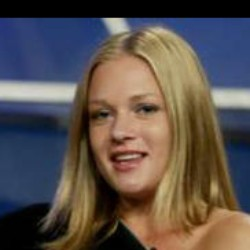

In [ ]:
# Checking if the image is at proper location

import cv2
sample_image = cv2.imread('/content/drive/MyDrive/AML_ASSIGNMENT_2/Data/lfw/AJ_Cook/AJ_Cook_0001.jpg')
cv2_imshow(sample_image)

In [3]:
# Storing the data into a data structure
dataset = '/content/drive/MyDrive/AML_ASSIGNMENT_2/Data/lfw'

In [ ]:
import os
import shutil
import random
import cv2

# Initialize a dictionary to store the count of images per person
person_image_count = {}

# Output directories for the splits
output_dir = '/content/drive/MyDrive/AML_ASSIGNMENT_2'

In [ ]:
# Create output directories
os.makedirs(os.path.join(output_dir, 'multiple_images'), exist_ok=True)

In [ ]:
import os
import shutil

# Setting the path for the new folder to save persons with more than one image
output_folder = '/content/drive/MyDrive/AML_ASSIGNMENT_2/multiple_images'

# Creating a dictionary to store the count of images for each person
person_image_count = {}

# Traversing the dataset folder
for root, dirs, files in os.walk(dataset):
    for file in files:
        # Extracting the person's name from the file path
        person_name = os.path.basename(root)

        # Incrementing the image count for this person
        person_image_count[person_name] = person_image_count.get(person_name, 0) + 1

# Counting the number of persons with more than one image
for person_name, image_count in person_image_count.items():
    if image_count > 1:
        # Copying the folder with more than one image to the output folder
        src_folder = os.path.join(dataset, person_name)
        dest_folder = os.path.join(output_folder, person_name)
        shutil.copytree(src_folder, dest_folder)

print(f"Number of persons with more than one image: {sum(count > 1 for count in person_image_count.values())}")


Number of persons with more than one image: 1680


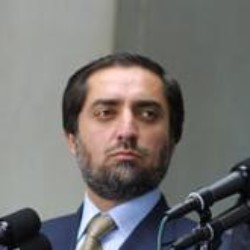

In [ ]:
# Checking if the multiple image is at proper location

import cv2
sample_image = cv2.imread('/content/drive/MyDrive/AML_ASSIGNMENT_2/multiple_images/Abdullah/Abdullah_0001.jpg')
cv2_imshow(sample_image)

**Que 3. Split into training, validation, and testing by person (not by image)**

In [4]:
import os
import random
import shutil

# Set the path to the folder containing folders of persons with more than one image
input_folder = '/content/drive/MyDrive/AML_ASSIGNMENT_2/multiple_images'

# Set the path for the output folders for training, validation, and testing
output_train_folder = '/content/drive/MyDrive/AML_ASSIGNMENT_2/training_images'
output_validation_folder = '/content/drive/MyDrive/AML_ASSIGNMENT_2/validation_images'
output_test_folder = '/content/drive/MyDrive/AML_ASSIGNMENT_2/testing_images'


In [ ]:
# Define the split ratios (e.g., 70% for training, 15% for validation, and 15% for testing)
train_ratio = 0.7
validation_ratio = 0.15
test_ratio = 0.15

# Creating output folders if they don't exist
for folder in [output_train_folder, output_validation_folder, output_test_folder]:
    if not os.path.exists(folder):
        os.makedirs(folder)

In [ ]:
# List all the person folders
person_folders = os.listdir(input_folder)

# Randomly shuffle the person folders for fair distribution
random.shuffle(person_folders)

# Calculate the split points
total_persons = len(person_folders)
train_split = int(total_persons * train_ratio)
validation_split = train_split + int(total_persons * validation_ratio)

# Perform the split
for i, person_folder in enumerate(person_folders):
    src_folder = os.path.join(input_folder, person_folder)

    if i < train_split:
        dest_folder = os.path.join(output_train_folder, person_folder)
    elif i < validation_split:
        dest_folder = os.path.join(output_validation_folder, person_folder)
    else:
        dest_folder = os.path.join(output_test_folder, person_folder)

    # Copy the entire person folder to the respective split folder
    shutil.copytree(src_folder, dest_folder)

print("Splitting into training, validation, and testing sets completed.")


Splitting into training, validation, and testing sets completed.


In [5]:
# Forming lists for train, test and validation which stores the person name and it's number of images

train_list = {}
val_list = {}
test_list = {}

# Traversing the dataset folder
for root, dirs, files in os.walk(output_train_folder):
    for file in files:
        # Extract the person's name from the file path
        person_name = os.path.basename(root)

        # Increment the image count for this person
        train_list[person_name] = train_list.get(person_name, 0) + 1

for root, dirs, files in os.walk(output_test_folder):
    for file in files:
        # Extract the person's name from the file path
        person_name = os.path.basename(root)

        # Increment the image count for this person
        test_list[person_name] = test_list.get(person_name, 0) + 1

for root, dirs, files in os.walk(output_validation_folder):
    for file in files:
        # Extract the person's name from the file path
        person_name = os.path.basename(root)

        # Increment the image count for this person
        val_list[person_name] = val_list.get(person_name, 0) + 1

print(train_list)
print(val_list)
print(test_list)

{'Eric_Rosser': 2, 'Sophia_Loren': 7, 'Carlos_Mesa': 2, 'Guillermo_Canas': 4, 'Andrew_Niccol': 2, 'Ethan_Hawke': 4, 'Tom_Brady': 2, 'Jennifer_Thompson': 2, 'Andy_Hebb': 2, 'Felix_Mantilla': 2, 'Frank_Cassell': 3, 'Martha_Bowen': 2, 'Steven_Hatfill': 2, 'Abdel_Nasser_Assidi': 2, 'Mikulas_Dzurinda': 2, 'Jason_Lezak': 2, 'Joe_Gatti': 2, 'Diana_Munz': 3, 'Petria_Thomas': 3, 'Lindsay_Benko': 2, 'Natalie_Coughlin': 6, 'Sachiko_Yamada': 4, 'Brian_Heidik': 2, 'Elizabeth_Hurley': 5, 'Jeffrey_Jones': 2, 'Arantxa_Sanchez-Vicario': 2, 'David_Bell': 2, 'Rick_Santorum': 3, 'Arsinee_Khanjian': 2, 'Francis_George': 2, 'Guy_Ritchie': 2, 'Margaret_Thatcher': 2, 'Robert_Ehrlich': 2, 'Jason_Jennings': 2, 'Dalai_Lama': 2, 'Phil_Gramm': 2, 'Oscar_Elias_Biscet': 2, 'Tim_Conway': 3, 'Jean_Carnahan': 2, 'Kathleen_Kennedy_Townsend': 4, 'Anders_Ebbeson': 3, 'Bob_Stoops': 7, 'Valdas_Adamkus': 2, 'Nancy_Sinatra': 2, 'Strom_Thurmond': 3, 'Dean_Barkley': 4, 'Placido_Domingo': 3, 'Alvaro_Noboa': 3, 'Michelle_Yeoh': 5

In [6]:
print(len(train_list))
print(len(val_list))
print(len(test_list))

1176
252
252


In [7]:
# Function to create the triplets that we want as input to our siamese network with an anchor, positive and negative image.

def create_triplets(directory, folder_list, max_files=10):
    triplets = []                                             # Initializing the triplets
    folders = list(folder_list.keys())                        # Names of the persons these will be used to go there actual image path

    for folder in folders:                                    # Iterating over all persons
        path = os.path.join(directory, folder)                # Path of that person's image folder
        files = list(os.listdir(path))[:max_files]            # Restricting number of files per person to less than 10 to avoid imbalance
        num_files = len(files)                                # Calculating that number of images for each person

        for i in range(num_files-1):                          # Iterating for an anchor image
            for j in range(i+1, num_files):                   # Iterating for a positive image
                anchor = (folder, f"{i+1}.jpg")               # Saving the anchor image
                positive = (folder, f"{j+1}.jpg")             # Saving the positive image from the same folder

                neg_folder = folder
                while neg_folder == folder:                   # We want negative folder to be other than the folder for the other 2 images
                    neg_folder = random.choice(folders)       # Randomizing till we get a different folder
                neg_file = random.randint(0, folder_list[neg_folder]-1)             # Select a random image from that different folder
                negative = (neg_folder, f"{neg_file+1}.jpg")  # Save that image as a negative image

                triplets.append((anchor, positive, negative)) # Combine all 3 images as a triplet

    random.shuffle(triplets)
    return triplets

In [8]:
# Creating the triplets for all 3 datasets we have

train_triplet = create_triplets(output_train_folder, train_list)
val_triplet = create_triplets(output_validation_folder, val_list)
test_triplet  = create_triplets(output_test_folder, test_list)

print("Number of training triplets:", len(train_triplet))
print("Number of validation triplets :", len(val_triplet))
print("Number of testing triplets :", len(test_triplet))

print("\nExamples of triplets:")
for i in range(5):
    print(train_triplet[i])

Number of training triplets: 9985
Number of validation triplets : 2274
Number of testing triplets : 2249

Examples of triplets:
(('Tiger_Woods', '3.jpg'), ('Tiger_Woods', '10.jpg'), ('Arye_Mekel', '1.jpg'))
(('Gordon_Brown', '4.jpg'), ('Gordon_Brown', '10.jpg'), ('Tom_Coverdale', '2.jpg'))
(('Sophia_Loren', '4.jpg'), ('Sophia_Loren', '7.jpg'), ('Chris_Rock', '1.jpg'))
(('Salma_Hayek', '5.jpg'), ('Salma_Hayek', '8.jpg'), ('Kelli_White', '2.jpg'))
(('Michael_Sullivan', '1.jpg'), ('Michael_Sullivan', '2.jpg'), ('Tracy_McGrady', '1.jpg'))


In [22]:
# Read the image from the desired folder we need to append zeros in name because of the naming format in the dataset.

def read_image(index):
    if len(index[1]) == 5:
      path = os.path.join(dataset, index[0], index[0] + '_000' + index[1])
    elif len(index[1]) == 6:
      path = os.path.join(dataset, index[0], index[0] + '_00' + index[1])
    else:
      path = os.path.join(dataset, index[0], index[0] + '_0' + index[1])

    image = cv2.imread(path)
    print(index)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Resizing the image to 128x128
    resize_img = cv2.resize(image, (128,128))
    return resize_img

**Defining the function for Image Augmentation**

( Reference Added in Last )

In [10]:
import scipy
from scipy import ndimage
import scipy.misc

def img_augmentation(img):
	if random.random()>0.7:

		h, w, c= np.shape(img)
		# translation
		if random.random() > 0.5:
			img = scipy.ndimage.shift(img, (int(random.random() * 20 - 10), int(random.random() * 20 - 10), 0))

		# rotation
		if random.random() > 0.5:
			img = scipy.ndimage.rotate(img, random.random() * 60 - 30)

		# flipping
		if random.random() > 0.5:
			img = np.flip(img, 1)

		# crop and padding
		h_c, w_c = img.shape[:2]
		if h_c > h:
			top = int(h_c / 2 - h / 2)
			left = int(w_c / 2 - w / 2)
			img_out = img[top: top + h, left: left + w]
		else:
			pad_size = int((h - h_c) / 2)
			pads = ((pad_size, pad_size), (pad_size, pad_size), (0, 0))
			img_out = np.pad(np.array(img), pads, 'constant', constant_values=0)
	else:
		img_out = img
	return img_out

In [11]:
# Function to get the batch in terms of actual input image format to pass to the model

def get_batch(triplet_list, batch_size=256, preprocess=True):
    batch_steps = len(triplet_list)//batch_size                                 # Length of the batch step

    for i in range(batch_steps+1):

        # Initialize all 3 arrays
        anchor   = []
        positive = []
        negative = []

        j = i*batch_size
        while j<(i+1)*batch_size and j<len(triplet_list):
            a, p, n = triplet_list[j]

            # Read the actual image and then augment it and append it to the respective place

            anchor.append(img_augmentation(read_image(a)))
            positive.append(img_augmentation(read_image(p)))
            negative.append(img_augmentation(read_image(n)))
            j+=1

        # Convert these images to array form
        anchor = np.array(anchor)
        positive = np.array(positive)
        negative = np.array(negative)

        # Preprocess the images according to imagenet

        if preprocess:
            anchor = preprocess_input(anchor)
            positive = preprocess_input(positive)
            negative = preprocess_input(negative)

        yield ([anchor, positive, negative])

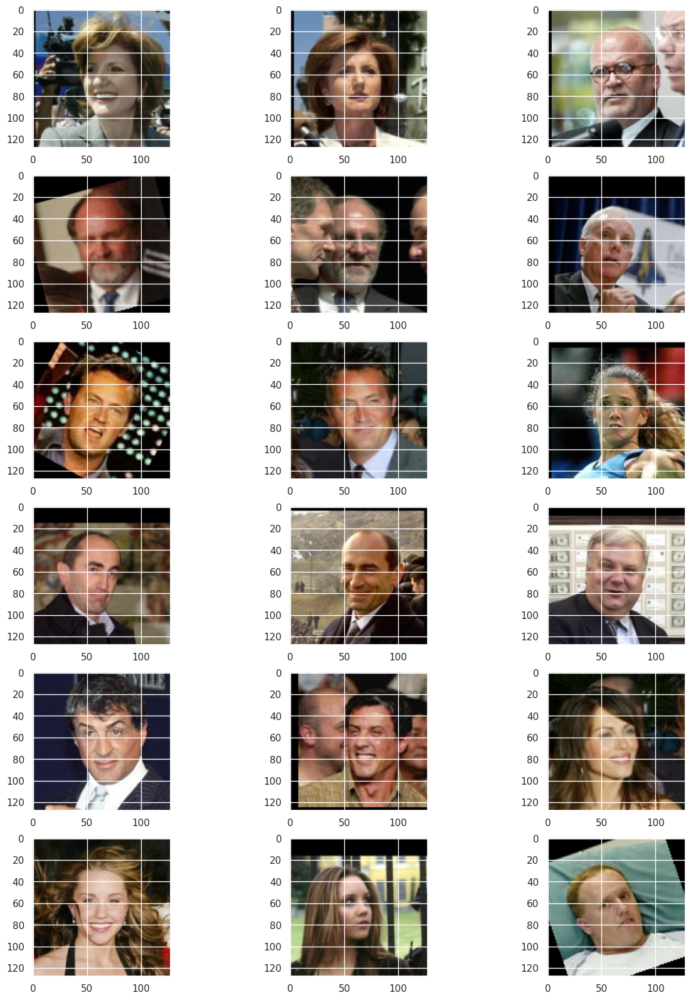

In [46]:
# Shows some example triplets
num_plots = 6

f, axes = plt.subplots(num_plots, 3, figsize=(15, 20))

for x in get_batch(train_triplet, batch_size=num_plots, preprocess=False):
    a,p,n = x
    for i in range(num_plots):
        axes[i, 0].imshow(a[i])
        axes[i, 1].imshow(p[i])
        axes[i, 2].imshow(n[i])
        i+=1
    break

**Que 4. Start with a network that is pre-trained on ImageNet and appropriate for your computational resources**

I have taken Xception as the pre-trained model on ImageNet

In [12]:
from tensorflow.keras import backend, layers, metrics

from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.applications import Xception, resnet
from tensorflow.keras.models import Model, Sequential

from tensorflow.keras.utils import plot_model
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [13]:
def get_encoder(input_shape):

    # Defining the pretrained model with specified input_shape
    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )

    # Making the weights of layers untrainable except the last 20 layers
    for i in range(len(pretrained_model.layers)-20):
        pretrained_model.layers[i].trainable = False

    # Making a classifier on top of the pretrained model with an L2 regularization
    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dense(256, activation="relu"),
        layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1))
    ], name="Encode_Model")
    return encode_model

**Que 5. Appropriately crop and resize the images based on your computational resources**

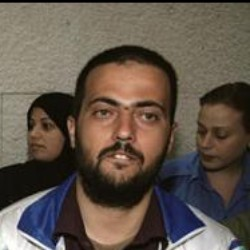

In [ ]:
import cv2
sample_image = cv2.imread('/content/drive/MyDrive/Assignment2_AML/train_images/Abdel_Nasser_Assidi/Abdel_Nasser_Assidi_0001.jpg')
cv2_imshow(sample_image)

In [ ]:
sample_image.shape

(250, 250, 3)

**The image size are 250x250 hence I have converted it to 128x128 directly while training to make the process faster.**

**Que 6. Setup and train a Siamese network to predict whether a pair of images are of the same person or not using a metric learning scheme (cosine similarity or Euclidean distance; paired with crossentropy or hinge loss with a margin), and validate on the validation split**

a) Use image augmentation

b) Experiment with a regularization technique and its hyper-parameter

**Using Image Augmentation and L2 Regularization**

The Image Augmentation and L2 Regularization has already been applied above in the read image part and encoder model respectively.

In [14]:
class DistanceLayer(layers.Layer):
    # A layer to compute distance between anchor and positive, anchor and negative
    def __init__(self, **kwargs):
        super().__init__(**kwargs)

    # Norm of distance
    def call(self, anchor, positive, negative):
        ap_distance = tf.reduce_sum(tf.square(anchor - positive), -1)
        an_distance = tf.reduce_sum(tf.square(anchor - negative), -1)
        return (ap_distance, an_distance)


def get_siamese_network(input_shape = (128, 128, 3)):
    encoder = get_encoder(input_shape)

    # Input Layers for the images
    anchor_input   = layers.Input(input_shape, name="Anchor_Input")
    positive_input = layers.Input(input_shape, name="Positive_Input")
    negative_input = layers.Input(input_shape, name="Negative_Input")

    # Generate the encodings (feature vectors) for the images
    encoded_a = encoder(anchor_input)
    encoded_p = encoder(positive_input)
    encoded_n = encoder(negative_input)

    # A layer to compute distance between anchor and positive, anchor and negative
    distances = DistanceLayer()(
        encoder(anchor_input),
        encoder(positive_input),
        encoder(negative_input)
    )

    # Creating the Model
    siamese_network = Model(
        inputs  = [anchor_input, positive_input, negative_input],
        outputs = distances,
        name = "Siamese_Network"
    )
    return siamese_network

siamese_network = get_siamese_network()
siamese_network.summary()


83683744/83683744 [==============================] - 0s 0us/step
Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                   

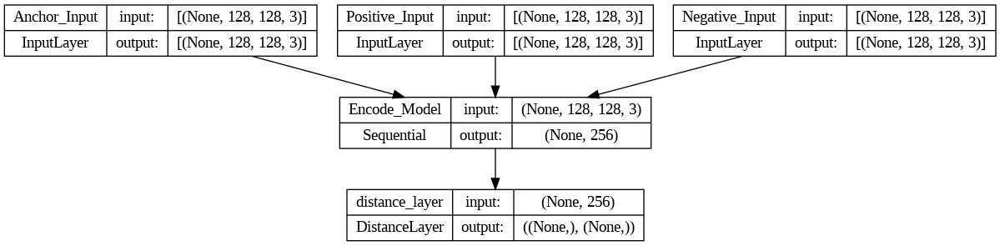

In [15]:
# Visualizing the model
plot_model(siamese_network, show_shapes=True, show_layer_names=True)

In [16]:
class SiameseModel(Model):
    # Builds a Siamese model based on a base-model
    def __init__(self, siamese_network, margin=1.0):
        super(SiameseModel, self).__init__()

        self.margin = margin
        self.siamese_network = siamese_network
        self.loss_tracker = metrics.Mean(name="loss")

    def call(self, inputs):
        return self.siamese_network(inputs)

    def train_step(self, data):
        # GradientTape get the gradients when we compute loss, and uses them to update the weights
        with tf.GradientTape() as tape:
            loss = self._compute_loss(data)

        gradients = tape.gradient(loss, self.siamese_network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.siamese_network.trainable_weights))

        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()}

    def test_step(self, data):
      loss = self._compute_loss(data)

      self.loss_tracker.update_state(loss)
      return {"loss": self.loss_tracker.result()}

    def _compute_loss(self, data):
        # Get the two distances from the network, then compute the triplet loss
        ap_distance, an_distance = self.siamese_network(data)
        loss = tf.maximum(ap_distance - an_distance + self.margin, 0.0)
        return loss

    @property
    def metrics(self):
        # We need to list our metrics so the reset_states() can be called automatically.
        return [self.loss_tracker]

In [17]:
siamese_model = SiameseModel(siamese_network)                # Final Siamese Model

optimizer = Adam(learning_rate=1e-3, epsilon=1e-01)          # Defining the optimizer and learning rate we are going to use
siamese_model.compile(optimizer=optimizer)                   # Compiling the model with the specified optimizer

In [23]:
# A function to test on the validation and Test dataset

def test_on_triplets(batch_size = 256):

    # Initializing positive and negative scores
    pos_scores, neg_scores = [], []

    # Get the batch of test data
    for data in get_batch(val_triplet[1:100], batch_size=batch_size):
        prediction = siamese_model.predict(data)                                # Run the prediction on the batch
        pos_scores += list(prediction[0])                                       # Append positive scores
        neg_scores += list(prediction[1])                                       # Append negative scores

    accuracy = np.sum(np.array(pos_scores) < np.array(neg_scores)) / len(pos_scores)   # Calculate the accuracy according to positive and negative scores

    print(f"Accuracy on validation = {accuracy:.5f}")
    return (accuracy)

**I have chosen number of epochs as 20 and batch size as 8 for optimal tradeoff between time taken and accuracy**

In [18]:
import time

save_all = False
epochs = 20                                                         # Specifying the number of epochs
batch_size = 8                                                      # Specifying the batch size

max_acc = 0
train_loss = []                                                     # Array to store the loss at each epoch
test_metrics = []                                                   # Array to store the accuracy of validation at each epoch

for epoch in range(1, epochs+1):                                    # Iterate over all epochs
    t = time.time()                                                 # Start the time to calculate the time per epoch

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:400], batch_size=batch_size):         # Get the training batch
        loss = siamese_model.train_on_batch(data)                               # Calculate the loss on that batch by passing it to the model
        epoch_loss.append(loss)                                                 # Append it to that epoch loss
    epoch_loss = sum(epoch_loss)/len(epoch_loss)                                # Calculate the final epoch loss after averaging each batch loss
    train_loss.append(epoch_loss)                                               # Append it to the actual loss

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")      # Caculate the time for epoch
    print(f"Loss on train    = {epoch_loss:.5f}")                               # Print the loss

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)                            # Now predict on the validation set
    test_metrics.append(metric)                                                 # Append the accuracy
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:                                           # If we get better accuracy then save the updated weights
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy                                                      # Update the max accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 555 sec)
Loss on train    = 0.69146
1/1 [==============================] - 0s 30ms/step
Accuracy on validation = 0.72727

EPOCH: 2 	 (Epoch done in 22 sec)
Loss on train    = 0.50795
1/1 [==============================] - 0s 36ms/step
Accuracy on validation = 0.73737

EPOCH: 3 	 (Epoch done in 21 sec)
Loss on train    = 0.41700
1/1 [==============================] - 0s 30ms/step
Accuracy on validation = 0.76768

EPOCH: 4 	 (Epoch done in 21 sec)
Loss on train    = 0.35081
1/1 [==============================] - 0s 30ms/step
Accuracy on validation = 0.79798

EPOCH: 5 	 (Epoch done in 21 sec)
Loss on train    = 0.29615
1/1 [==============================] - 0s 53ms/step
Accuracy on validation = 0.73737

EPOCH: 6 	 (Epoch done in 21 sec)
Loss on train    = 0.25813
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.75758

EPOCH: 7 	 (Epoch done in 20 sec)
Loss on train    = 0.22640
1/1 [==============================] - 0s 32ms/step
Acc

**For Regularization we will experiment with another technique i.e. Dropout hence changing the encoder model accordingly replacing L2 layer with Dropout**

**Adding Dropout Layer**

In [19]:
# Same comments as above

def get_encoder(input_shape):
    print("Model with Dropout")

    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )

    for i in range(len(pretrained_model.layers)-27):
        pretrained_model.layers[i].trainable = False

    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dense(256, activation="relu"),
        layers.Dropout(0.5)                                         # Adding Dropout layer instead of L2 Regularization
    ], name="Encode_Model")
    return encode_model

In [20]:
siamese_network = get_siamese_network()
siamese_network.summary()

Model with Dropout
Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                 

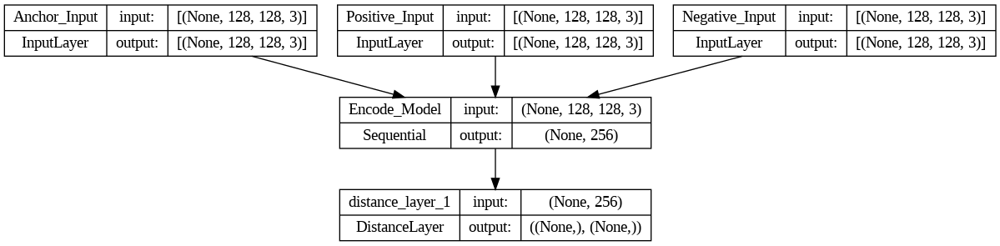

In [21]:
plot_model(siamese_network, show_shapes=True, show_layer_names=True)

In [22]:
siamese_model = SiameseModel(siamese_network)

optimizer = Adam(learning_rate=1e-3, epsilon=1e-01)
siamese_model.compile(optimizer=optimizer)

In [24]:
import time

save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:500], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 40 sec)
Loss on train    = 0.78348
1/1 [==============================] - 0s 32ms/step
Accuracy on validation = 0.78788

EPOCH: 2 	 (Epoch done in 21 sec)
Loss on train    = 0.38500
1/1 [==============================] - 0s 41ms/step
Accuracy on validation = 0.76768

EPOCH: 3 	 (Epoch done in 20 sec)
Loss on train    = 0.32138
1/1 [==============================] - 0s 49ms/step
Accuracy on validation = 0.76768

EPOCH: 4 	 (Epoch done in 20 sec)
Loss on train    = 0.30448
1/1 [==============================] - 0s 42ms/step
Accuracy on validation = 0.74747

EPOCH: 5 	 (Epoch done in 21 sec)
Loss on train    = 0.24976
1/1 [==============================] - 0s 45ms/step
Accuracy on validation = 0.78788

EPOCH: 6 	 (Epoch done in 20 sec)
Loss on train    = 0.21470
1/1 [==============================] - 0s 30ms/step
Accuracy on validation = 0.80808

EPOCH: 7 	 (Epoch done in 21 sec)
Loss on train    = 0.22462
1/1 [==============================] - 0s 32ms/step
Accu

**For Dropout I observed that training loss was not decreasing continuously and also the average accuracy for L2 was better hence I will continue in further code with L2 as regularization.**

In [25]:
def get_encoder(input_shape):

    # Defining the pretrained model with specified input_shape
    pretrained_model = Xception(
        input_shape=input_shape,
        weights='imagenet',
        include_top=False,
        pooling='avg',
    )

    # Making the weights of layers untrainable except the last 20 layers
    for i in range(len(pretrained_model.layers)-20):
        pretrained_model.layers[i].trainable = False

    # Making a classifier on top of the pretrained model with an L2 regularization
    encode_model = Sequential([
        pretrained_model,
        layers.Flatten(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dense(256, activation="relu"),
        layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1))
    ], name="Encode_Model")
    return encode_model

In [26]:
siamese_network = get_siamese_network()
siamese_network.summary()

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                    

**Que 7. Experiment with at least two learning rate schedulers and comment on what works, doesn’t work, and potential reason why**

Learning Rate Schedulers to be used :

1. Exponential
2. Step- wise

**Exponential Learning Rate Scheduler**

In [27]:
from tensorflow.keras.optimizers.schedules import ExponentialDecay

# Define the learning rate schedule
initial_learning_rate = 0.001  # Initial learning rate
decay_steps = 1000  # Number of steps before learning rate decay
decay_rate = 0.9  # The factor by which the learning rate will decay

# Create the learning rate schedule
lr_schedule = ExponentialDecay(
    initial_learning_rate,
    decay_steps=decay_steps,
    decay_rate=decay_rate,
    staircase=False  # Set to True for discrete steps in decay
)

In [28]:
siamese_model = SiameseModel(siamese_network)

optimizer = Adam(learning_rate=lr_schedule, epsilon=1e-01)
siamese_model.compile(optimizer=optimizer)

In [29]:
import time

save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:500], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 36 sec)
Loss on train    = 0.69973
1/1 [==============================] - 0s 30ms/step
Accuracy on validation = 0.76768

EPOCH: 2 	 (Epoch done in 22 sec)
Loss on train    = 0.50013
1/1 [==============================] - 0s 30ms/step
Accuracy on validation = 0.77778

EPOCH: 3 	 (Epoch done in 19 sec)
Loss on train    = 0.40879
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.75758

EPOCH: 4 	 (Epoch done in 20 sec)
Loss on train    = 0.36363
1/1 [==============================] - 0s 46ms/step
Accuracy on validation = 0.79798

EPOCH: 5 	 (Epoch done in 20 sec)
Loss on train    = 0.28117
1/1 [==============================] - 0s 48ms/step
Accuracy on validation = 0.76768

EPOCH: 6 	 (Epoch done in 20 sec)
Loss on train    = 0.21757
1/1 [==============================] - 0s 29ms/step
Accuracy on validation = 0.75758

EPOCH: 7 	 (Epoch done in 21 sec)
Loss on train    = 0.22309
1/1 [==============================] - 0s 33ms/step
Accu

**Step - wise Learning Rate Scheduler**

In [47]:
from tensorflow.keras.optimizers.schedules import ExponentialDecay

# Define the learning rate schedule
initial_learning_rate = 0.001  # Initial learning rate
decay_steps = 1000  # Number of steps before learning rate decay
decay_rate = 0.9  # The factor by which the learning rate will decay

# Create the learning rate schedule
lr_schedule = ExponentialDecay(
    initial_learning_rate,
    decay_steps=decay_steps,
    decay_rate=decay_rate,
    staircase=True  # Set to True for discrete steps in decay
)

In [48]:
siamese_network = get_siamese_network()
siamese_network.summary()

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [49]:
siamese_model = SiameseModel(siamese_network)

optimizer = Adam(learning_rate=lr_schedule, epsilon=1e-01)
siamese_model.compile(optimizer=optimizer)

In [50]:
import time

save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:500], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 36 sec)
Loss on train    = 0.70446
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.73737

EPOCH: 2 	 (Epoch done in 26 sec)
Loss on train    = 0.50669
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.71717

EPOCH: 3 	 (Epoch done in 22 sec)
Loss on train    = 0.41502
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.73737

EPOCH: 4 	 (Epoch done in 22 sec)
Loss on train    = 0.35384
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.73737

EPOCH: 5 	 (Epoch done in 21 sec)
Loss on train    = 0.31887
1/1 [==============================] - 0s 32ms/step
Accuracy on validation = 0.74747

EPOCH: 6 	 (Epoch done in 23 sec)
Loss on train    = 0.25213
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.78788

EPOCH: 7 	 (Epoch done in 21 sec)
Loss on train    = 0.21967
1/1 [==============================] - 0s 37ms/step
Accu

**On average the accuracy for validation set is more if we use the learning rate scheduler as exponential this may be because the exponential learning rate will converge faster due to which for small epochs it is giving better results for large epochs step wise learning rate scheduler might give better results.**

**Que 8. Experiment with at least two different optimizers and comment on what works, doesn’t work, and potential reason why**

Optimizers to be used :

1. Adam ( We used this before )
2. SGD
3. RmsProp


**Optimizer as SGD ( Stochastic Gradient Descent )**

In [51]:
siamese_network = get_siamese_network()
siamese_network.summary()

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [57]:
siamese_model = SiameseModel(siamese_network)

optimizer_sgd = SGD(learning_rate=1e-3)
siamese_model.compile(optimizer=optimizer_sgd)

In [58]:
import time

save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:500], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 41 sec)
Loss on train    = 0.68143
1/1 [==============================] - 0s 38ms/step
Accuracy on validation = 0.70707

EPOCH: 2 	 (Epoch done in 21 sec)
Loss on train    = 0.52220
1/1 [==============================] - 0s 35ms/step
Accuracy on validation = 0.71717

EPOCH: 3 	 (Epoch done in 20 sec)
Loss on train    = 0.45678
1/1 [==============================] - 0s 34ms/step
Accuracy on validation = 0.70707

EPOCH: 4 	 (Epoch done in 20 sec)
Loss on train    = 0.40547
1/1 [==============================] - 0s 46ms/step
Accuracy on validation = 0.73737

EPOCH: 5 	 (Epoch done in 21 sec)
Loss on train    = 0.36490
1/1 [==============================] - 0s 51ms/step
Accuracy on validation = 0.74747

EPOCH: 6 	 (Epoch done in 20 sec)
Loss on train    = 0.31644
1/1 [==============================] - 0s 32ms/step
Accuracy on validation = 0.66667

EPOCH: 7 	 (Epoch done in 21 sec)
Loss on train    = 0.27105
1/1 [==============================] - 0s 31ms/step
Accu

**Optimizer as RMS prop**

In [59]:
siamese_network = get_siamese_network()
siamese_network.summary()

Model: "Siamese_Network"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Anchor_Input (InputLayer)   [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 Positive_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 Negative_Input (InputLayer  [(None, 128, 128, 3)]        0         []                            
 )                                                                                                
                                                                                    

In [60]:
siamese_model = SiameseModel(siamese_network)

optimizer_rms = RMSprop(learning_rate=1e-3, epsilon=1e-01)
siamese_model.compile(optimizer=optimizer_rms)

In [61]:
import time

save_all = False
epochs = 20
batch_size = 8

max_acc = 0
train_loss = []
test_metrics = []

for epoch in range(1, epochs+1):
    t = time.time()

    # Training the model on train data
    epoch_loss = []
    for data in get_batch(train_triplet[1:500], batch_size=batch_size):
        loss = siamese_model.train_on_batch(data)
        epoch_loss.append(loss)
    epoch_loss = sum(epoch_loss)/len(epoch_loss)
    train_loss.append(epoch_loss)

    print(f"\nEPOCH: {epoch} \t (Epoch done in {int(time.time()-t)} sec)")
    print(f"Loss on train    = {epoch_loss:.5f}")

    # Testing the model on validation data
    metric = test_on_triplets(batch_size=batch_size)
    test_metrics.append(metric)
    accuracy = metric

    # Saving the model weights
    if save_all or accuracy>=max_acc:
        siamese_model.save_weights("siamese_model")
        max_acc = accuracy

# Saving the model after all epochs run
siamese_model.save_weights("siamese_model-final")


EPOCH: 1 	 (Epoch done in 36 sec)
Loss on train    = 0.65293
1/1 [==============================] - 0s 55ms/step
Accuracy on validation = 0.76768

EPOCH: 2 	 (Epoch done in 20 sec)
Loss on train    = 0.49952
1/1 [==============================] - 0s 53ms/step
Accuracy on validation = 0.73737

EPOCH: 3 	 (Epoch done in 23 sec)
Loss on train    = 0.40476
1/1 [==============================] - 0s 47ms/step
Accuracy on validation = 0.70707

EPOCH: 4 	 (Epoch done in 21 sec)
Loss on train    = 0.33442
1/1 [==============================] - 0s 46ms/step
Accuracy on validation = 0.77778

EPOCH: 5 	 (Epoch done in 20 sec)
Loss on train    = 0.27309
1/1 [==============================] - 0s 53ms/step
Accuracy on validation = 0.75758

EPOCH: 6 	 (Epoch done in 22 sec)
Loss on train    = 0.22128
1/1 [==============================] - 0s 31ms/step
Accuracy on validation = 0.77778

EPOCH: 7 	 (Epoch done in 20 sec)
Loss on train    = 0.16600
1/1 [==============================] - 0s 31ms/step
Accu

**Clearly Adam was giving better results on average as compared to SGD or RMSProp optimizer, this is because ADAM is basically a combination of SGD as well as RMSProp hence it has qualities of both these optimizers thus performs better.**

**Que 9. Test on the test split**

In [ ]:
def test_on_triplets(batch_size = 256):
    pos_scores, neg_scores = [], []

    for data in get_batch(test_triplet[1:100], batch_size=batch_size):
        prediction = siamese_model.predict(data)
        pos_scores += list(prediction[0])
        neg_scores += list(prediction[1])

    accuracy = np.sum(np.array(pos_scores) < np.array(neg_scores)) / len(pos_scores)
    ap_mean = np.mean(pos_scores)
    an_mean = np.mean(neg_scores)
    ap_stds = np.std(pos_scores)
    an_stds = np.std(neg_scores)

    print(f"Accuracy on test = {accuracy:.5f}")
    return (accuracy, ap_mean, an_mean, ap_stds, an_stds)

metric = test_on_triplets(batch_size=batch_size)

1/1 [==============================] - 0s 31ms/step
Accuracy on test = 0.79661


**Que 10. Gather a few images of yourself and your friends (with their consent) and check if the model works well on this data**

In [24]:
output_friends_folder = '/content/drive/MyDrive/AML_ASSIGNMENT_2/Friends'

In [40]:
# Read the image from the desired folder we need to append zeros in name because of the naming format in the dataset.
def read_image(index):
    path = os.path.join('/content/drive/MyDrive/AML_ASSIGNMENT_2/Friends', index[0], index[0] + index[1])
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Resizing the image to 128x128
    resize_img = cv2.resize(image, (128,128))
    return resize_img


In [39]:
friends_list = {}

# Traverse the dataset folder
for root, dirs, files in os.walk(output_friends_folder):
    for file in files:
        # Extract the person's name from the file path
        person_name = os.path.basename(root)

        # Increment the image count for this person
        friends_list[person_name] = friends_list.get(person_name, 0) + 1

In [41]:
print(friends_list)

{'Mohit': 6, 'Vrinda': 4, 'Jahnvi': 3}


In [42]:
friends_triplet = create_triplets(output_friends_folder, friends_list)

In [43]:
print(friends_triplet)
print(len(friends_triplet))

[(('Mohit', '1.jpg'), ('Mohit', '4.jpg'), ('Jahnvi', '2.jpg')), (('Mohit', '1.jpg'), ('Mohit', '3.jpg'), ('Jahnvi', '3.jpg')), (('Mohit', '3.jpg'), ('Mohit', '5.jpg'), ('Jahnvi', '1.jpg')), (('Vrinda', '1.jpg'), ('Vrinda', '3.jpg'), ('Jahnvi', '1.jpg')), (('Jahnvi', '2.jpg'), ('Jahnvi', '3.jpg'), ('Mohit', '4.jpg')), (('Vrinda', '1.jpg'), ('Vrinda', '4.jpg'), ('Mohit', '3.jpg')), (('Mohit', '3.jpg'), ('Mohit', '6.jpg'), ('Jahnvi', '3.jpg')), (('Mohit', '2.jpg'), ('Mohit', '3.jpg'), ('Jahnvi', '2.jpg')), (('Mohit', '2.jpg'), ('Mohit', '4.jpg'), ('Vrinda', '1.jpg')), (('Vrinda', '2.jpg'), ('Vrinda', '4.jpg'), ('Jahnvi', '1.jpg')), (('Mohit', '1.jpg'), ('Mohit', '6.jpg'), ('Jahnvi', '3.jpg')), (('Vrinda', '2.jpg'), ('Vrinda', '3.jpg'), ('Jahnvi', '1.jpg')), (('Mohit', '2.jpg'), ('Mohit', '6.jpg'), ('Jahnvi', '1.jpg')), (('Mohit', '3.jpg'), ('Mohit', '4.jpg'), ('Vrinda', '2.jpg')), (('Jahnvi', '1.jpg'), ('Jahnvi', '3.jpg'), ('Mohit', '2.jpg')), (('Mohit', '2.jpg'), ('Mohit', '5.jpg'), ('Vr

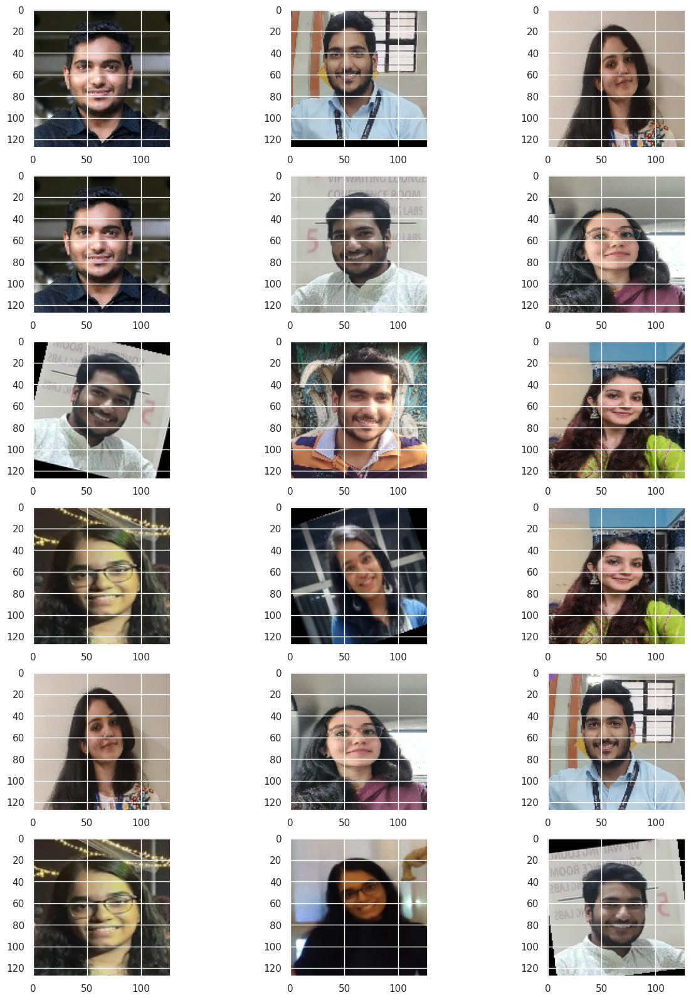

In [44]:
# Shows some example triplets
num_plots = 6

f, axes = plt.subplots(num_plots, 3, figsize=(15, 20))

for x in get_batch(friends_triplet, batch_size=num_plots, preprocess=False):
    a,p,n = x
    for i in range(num_plots):
        axes[i, 0].imshow(a[i])
        axes[i, 1].imshow(p[i])
        axes[i, 2].imshow(n[i])
        i+=1
    break

In [61]:
def test_on_triplets(batch_size = 4):
    pos_scores, neg_scores = [], []

    for data in get_batch(friends_triplet[1:20], batch_size=batch_size):
        prediction = siamese_model.predict(data)
        pos_scores += list(prediction[0])
        neg_scores += list(prediction[1])

    accuracy = np.sum(np.array(pos_scores) < np.array(neg_scores)) / len(pos_scores)
    ap_mean = np.mean(pos_scores)
    an_mean = np.mean(neg_scores)
    ap_stds = np.std(pos_scores)
    an_stds = np.std(neg_scores)

    print(f"Accuracy on Friends Test Data = {accuracy:.5f}")
    return (accuracy, ap_mean, an_mean, ap_stds, an_stds)

metric = test_on_triplets(batch_size=4)

1/1 [==============================] - 0s 30ms/step
Accuracy on Friends Test Data = 0.63158


**On the dataset of friends we get a comparatively quite low accuracy as compared to the trained one this may be due to image quality and the trained dataset**

**Part-B**

**Que 11. Train a generative model for generating face images, using a GAN. The generator takes a Gaussian noise vector as input, and tries to output a face image, while the discriminator distinguishes between real and fake face images. See, for example:**

https://www.youtube.com/watch?v=_pIMdDWK5sc

The below code is referred entirely from : https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [62]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000)
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [74]:
# Root directory for dataset
dataroot = '/content/drive/MyDrive/AML_ASSIGNMENT_2/training_images'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

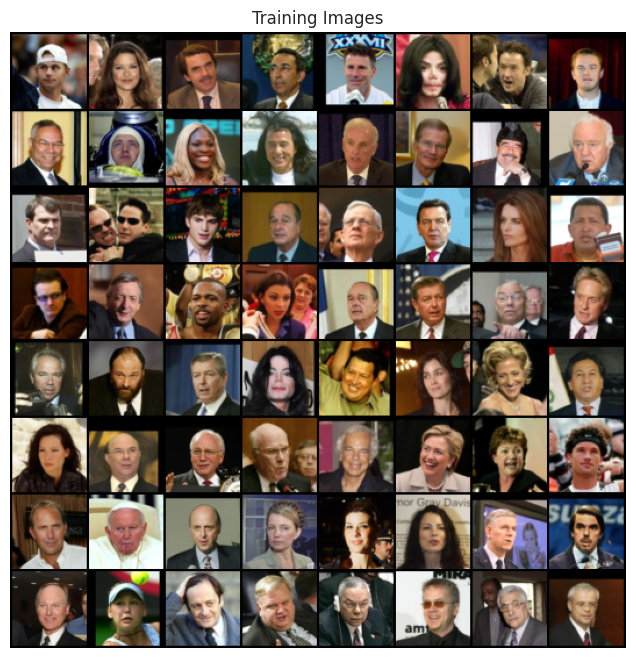

In [75]:
# Creating the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [65]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [66]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [67]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [68]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),

            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [69]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [70]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [76]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(100):

    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        # Train with all-real batch
        netD.zero_grad()

        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)

        # Calculate loss on all-real batch
        errD_real = criterion(output, label)

        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        # Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)

        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)

        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)

        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake

        # Update D
        optimizerD.step()

        # Update G network: maximize log(D(G(z)))
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost

        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)

        # Calculate G's loss based on this output
        errG = criterion(output, label)

        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()

        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, 100, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == 100-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/47]	Loss_D: 0.0408	Loss_G: 33.6009	D(x): 0.9784	D(G(z)): 0.0000 / 0.0000
[1/100][0/47]	Loss_D: 0.0001	Loss_G: 38.8553	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[2/100][0/47]	Loss_D: 0.0000	Loss_G: 37.8802	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[3/100][0/47]	Loss_D: 0.2619	Loss_G: 6.9557	D(x): 0.9342	D(G(z)): 0.0764 / 0.0030
[4/100][0/47]	Loss_D: 0.5291	Loss_G: 3.2711	D(x): 0.7854	D(G(z)): 0.1789 / 0.0520
[5/100][0/47]	Loss_D: 0.6711	Loss_G: 3.4600	D(x): 0.6609	D(G(z)): 0.0384 / 0.0474
[6/100][0/47]	Loss_D: 0.2740	Loss_G: 5.8587	D(x): 0.8557	D(G(z)): 0.0406 / 0.0065
[7/100][0/47]	Loss_D: 0.3939	Loss_G: 4.4514	D(x): 0.8376	D(G(z)): 0.1233 / 0.0239
[8/100][0/47]	Loss_D: 0.6722	Loss_G: 3.8593	D(x): 0.7652	D(G(z)): 0.2492 / 0.0363
[9/100][0/47]	Loss_D: 0.8194	Loss_G: 2.6974	D(x): 0.5589	D(G(z)): 0.0386 / 0.1012
[10/100][0/47]	Loss_D: 1.2295	Loss_G: 8.3092	D(x): 0.9248	D(G(z)): 0.5759 / 0.0011
[11/100][0/47]	Loss_D: 0.4599	Loss_G: 5.3295	D(x): 0.8575	D(G(z)): 0

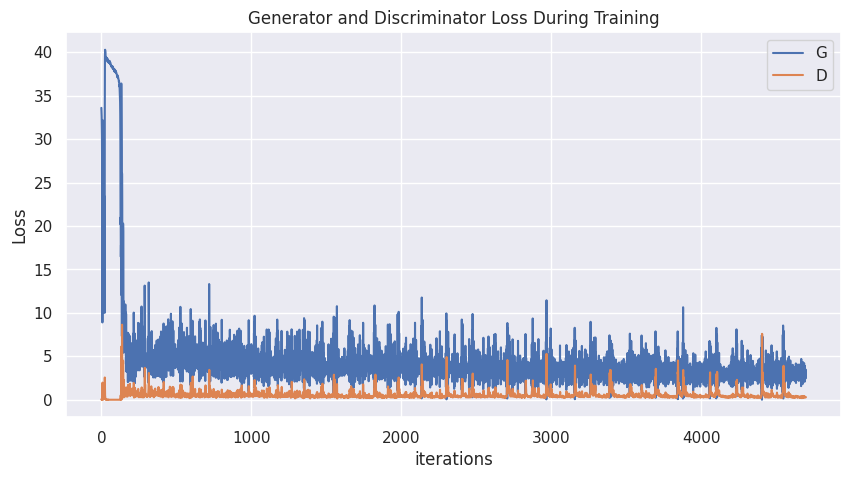

In [77]:
# Plotting the Generator and Discriminator Losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

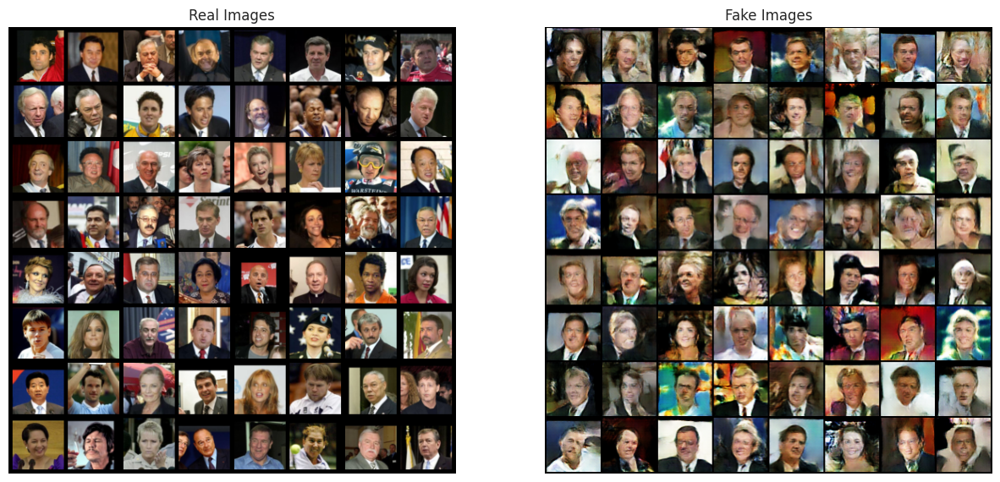

In [78]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()


**BONUS PART**


**Que 12. (Bonus) Modify the GAN to become a conditional GAN, where the condition itself is (features of) a real face image. The CGAN should generate another image of the same person, and you can use the Siamese network from Part-A as an additional discriminator for person matching. You will need to ensure that it does not simply show the same image as the one used for conditional input. See, for instance**

https://www.youtube.com/watch?v=Hp-jWm2SzR8

**Making a conditional GAN which will be conditional on such a huge dataset is a quite big task which will require a lot of time for training and a lot of GPU requirements. Therefore, I have used 2 persons from the lfw dataset with the maximum number of images and tried to make a conditional model for them.**

Referred the below code from : https://wandb.ai/ishandutta/W%26B_Generate_Faces_using_ConditionalGAN/reports/Face-Generation-using-ConditionalGANs--VmlldzozMTcwODY1

In [1]:
# Importing the required libraries

!pip install -q --upgrade torch_snippets
from torch_snippets import *

import torch
from torchvision.utils import make_grid
from torch_snippets import *
from PIL import Image
import torchvision
from torchvision import transforms
import torchvision.utils as vutils

import numpy as np
import pandas as pd

import glob
from tqdm import tqdm

import matplotlib.pyplot as plt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.4/65.4 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 7.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.7/203.7 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 53.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 47.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 66.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.6/30.6 MB 22.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.4/169.4 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 35.0 MB/s eta 0:

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# Saving the person list along with the number of images to find the 2 most images people

persons_list = {}

# Traverse the dataset folder
for root, dirs, files in os.walk('/content/drive/MyDrive/AML_ASSIGNMENT_2/multiple_images'):
    for file in files:
        # Extract the person's name from the file path
        person_name = os.path.basename(root)

        # Increment the image count for this person
        persons_list[person_name] = persons_list.get(person_name, 0) + 1

In [5]:
print(persons_list)

{
    'Mikhail_Youzhny': 3,
    'Minnie_Driver': 2,
    'Jennifer_Connelly': 4,
    'Steven_Seagal': 2,
    'Ann_Veneman': 11,
    'Garry_Kasparov': 2,
    'Robert_Redford': 8,
    'Claire_Leger': 2,
    'Patricia_Clarkson': 4,
    'Bernard_Lord': 2,
    'Steffi_Graf': 5,
    'Gordon_Campbell': 2,
    'Harry_Schmidt': 4,
    'Jesse_James_Leija': 2,
    'Leon_LaPorte': 2,
    'Michael_Keaton': 2,
    'Elena_Bovina': 3,
    'Charles_Taylor': 9,
    'Thomas_Rupprath': 3,
    'Morgan_Freeman': 2,
    'Jennifer_Keller': 4,
    'Holly_Hunter': 7,
    'Vivica_Fox': 2,
    'Ashton_Kutcher': 3,
    'Heizo_Takenaka': 9,
    'Brian_Cowen': 2,
    'Nicolas_Escude': 2,
    'Marty_Mornhinweg': 3,
    'Jimmy_Kimmel': 2,
    'Mikhail_Wehbe': 4,
    'William_Bratton': 3,
    'Jeb_Bush': 12,
    'Jeremy_Shockey': 2,
    'Jim_Hahn': 4,
    'Robbie_Fowler': 2,
    'Sonia_Gandhi': 4,
    'Maureen_Fanning': 2,
    'Tippi_Hedren': 2,
    'Melanie_Griffith': 3,
    'Sadie_Frost': 3,
    'Len_Jenoff': 2,
    'Iva_Majoli': 2,
    'Juan_Manuel_Marquez': 3,
    'Guillermo_Ortiz': 2,
    'Barbara_Walters': 4,
    'David_Nalbandian': 14,
    'Christina_Aguilera': 4,
    'Magdalena_Maleeva': 3,
    'Carmen_Electra': 6,
    'Eduard_Shevardnadze': 5,
    'Aleksander_Kwasniewski': 4,
    'Jolanta_Kwasniewski': 2,
    'Larry_Johnson': 2,
    'Daisy_Fuentes': 4,
    'Guillaume_Soro': 2,
    'Edward_Norton': 2,
    'Gro_Harlem_Brundtland': 2,
    'Steven_Spielberg': 7,
    'David_Caraway': 2,
    'Leonardo_DiCaprio': 9,
    'Bobby_Goldwater': 2,
    'Matt_Dillon': 3,
    'Natalie_Maines': 5,
    'Masahiko_Nagasawa': 2,
    'Takashi_Sorimachi': 2,
    'Natasha_McElhone': 3,
    'Fabrice_Santoro': 3,
    'Andy_Roddick': 15,
    'Vaclav_Klaus': 2,
    'Amram_Mitzna': 2,
    'Bill_Callahan': 3,
    'Christopher_Reeve': 4,
    'Leslie_Moonves': 2,
    'Ashanti': 5,
    'Nathan_Lane': 2,
    'Jon_Gruden': 7,
    'Marcelo_Ebrard': 3,
    'Jorge_Castaneda': 2,
    'Nicolas_Lapentti': 2,
    'Nia_Vardalos': 5,
    'Heidi_Klum': 5,
    'James_Kelly': 11,
    'James_Blake': 14,
    'Tyra_Banks': 2,
    'Mike_Price': 2,
    'Trent_Lott': 16,
    'Bill_Parcells': 2,
    'Rich_Gannon': 2,
    'Lim_Dong-won': 2,
    'King_Abdullah_II': 5,
    'James_Jones': 2,
    'Arlen_Specter': 3,
    'Richard_Armitage': 9,
    'Denise_Johnson': 2,
    'Gary_Carter': 3,
    'George_Foreman': 2,
    'Matthew_Broderick': 4,
    'Coretta_Scott_King': 3,
    'Alexander_Losyukov': 4,
    'John_Bolton': 17,
    'Amanda_Coetzer': 2,
    'Chanda_Rubin': 5,
    'Prince_Naruhito': 3,
    'Michael_Chiklis': 5,
    'Harry_Belafonte': 2,
    'Akhmed_Zakayev': 3,
    'Thabo_Mbeki': 5,
    'Elijah_Wood': 3,
    'Ed_Rosenthal': 3,
    'Bobby_Robson': 2,
    'Xavier_Malisse': 5,
    'David_Heyman': 2,
    'Vaclav_Havel': 9,
    'James_Butts': 2,
    'Gary_Locke': 2,
    'Latrell_Sprewell': 2,
    'Osama_bin_Laden': 4,
    'Sharon_Stone': 5,
    'Guy_Hemmings': 2,
    'Ismail_Merchant': 2,
    'George_Ryan': 4,
    'Tim_Curry': 2,
    'Barry_Zito': 2,
    'Vince_Gill': 2,
    'Robin_Cook': 2,
    'Mary_Steenburgen': 3,
    'Chris_Cooper': 2,
    'Sally_Kirkland': 4,
    'Jimmy_Carter': 9,
    'Joerg_Haider': 2,
    'Eric_Clapton': 2,
    'Michael_Caine': 4,
    'Woody_Allen': 5,
    'John_Reilly': 2,
    'Jessica_Lange': 2,
    'Antony_Leung': 4,
    'Miguel_Estrada': 2,
    'Robbie_Williams': 3,
    'Evander_Holyfield': 2,
    'Dexter_Jackson': 2,
    'Iain_Duncan_Smith': 4,
    'Stan_Heath': 2,
    'Gilberto_Rodriguez_Orejuela': 4,
    'Jia_Qinglin': 2,
    'Gary_Williams': 2,
    'Paul_Patton': 2,
    'Carlos_Ghosn': 2,
    'Howard_Schultz': 2,
    'David_Wells': 7,
    'Paul_Gascoigne': 3,
    'Adam_Scott': 2,
    'Larry_Bowa': 2,
    'Mark_Cuban': 2,
    'Kelvin_Sampson': 3,
    'Carlos_Ortega': 3,
    'Rick_Barnes': 3,
    'Thomas_Fargo': 4,
    'Jamie_Villafane': 2,
    'Leonid_Kuchma': 6,
    'Vidar_Helgesen': 2,
    'Debbie_Reynolds': 4,
    'Franco_Dragone': 2,
    'Elinor_Caplan': 2,
    'Alexander

We observe that the persons with the maximum images are :

Colin Powell (236 images) and George W Bush (530 images)

In [6]:
# Storing the images for both these persons from there directories

colin_images = Glob('/content/drive/MyDrive/GAN_PARTB/Colin_Powell/*.jpg')
george_images = Glob('/content/drive/MyDrive/GAN_PARTB/George_W_Bush/*.jpg')

In [7]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

In [14]:
# Creating new directories for these persons where we will store the processed images

!mkdir cropped_faces_colin
!mkdir cropped_faces_george

for i in range(len(colin_images)):
    img = read(colin_images[i],1)                                               # Reading the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)                                # Converting to greyscale
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)                         # Detecting only the face in image

    for (x,y,w,h) in faces:
        img2 = img[y:(y+h),x:(x+w),:]
    cv2.imwrite('cropped_faces_colin/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))  # Write the updated image with only face

# Same comments as above for the other person

for i in range(len(george_images)):
    img = read(george_images[i],1)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)

    for (x,y,w,h) in faces:
        img2 = img[y:(y+h),x:(x+w),:]
    cv2.imwrite('cropped_faces_george/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))

mkdir: cannot create directory ‘cropped_faces_colin’: File exists
mkdir: cannot create directory ‘cropped_faces_george’: File exists


In [15]:
# Defining the transform function to transform the images

transform=transforms.Compose([
                               transforms.Resize(64),
                               transforms.CenterCrop(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ])

In [16]:
# Making the dataset to give to the dataloader

class Faces(Dataset):
    def __init__(self, folders):
        super().__init__()
        self.foldercolin = folders[0]                                               # Storing the colin folder
        self.foldergeorge = folders[1]                                              # Storing George folder
        self.images=sorted(Glob(self.foldercolin))+sorted(Glob(self.foldergeorge))  # Sort the images in both folders

    def __len__(self):
        return len(self.images)                                                     # Returns length of images

    def __getitem__(self, ix):
        image_path = self.images[ix]                                                # Path of image
        image = Image.open(image_path)
        image = transform(image)
        gender = np.where('colin' in str(image_path),1,0)
        return image, torch.tensor(gender).long()

In [17]:
ds = Faces(folders=['cropped_faces_colin','cropped_faces_george'])
dataloader = DataLoader(ds, batch_size=64, shuffle=True, num_workers=8)             # Create the dataloader for image

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [18]:
# Function to initialize the weights

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)

    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [19]:
# Defining the Discriminator model
# Code directly referred from https://wandb.ai/ishandutta/W%26B_Generate_Faces_using_ConditionalGAN/reports/Face-Generation-using-ConditionalGANs--VmlldzozMTcwODY1

class Discriminator(nn.Module):
    def __init__(self, emb_size=32):
        super(Discriminator, self).__init__()
        self.emb_size = 32
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(
            nn.Conv2d(3,64,4,2,1,bias=False),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*2,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*4,64*8,4,2,1,bias=False),
            nn.BatchNorm2d(64*8),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*8,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Flatten()
        )
        self.model2 = nn.Sequential(
            nn.Linear(288,100),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Linear(100,1),
            nn.Sigmoid()
        )
        self.apply(weights_init)
    def forward(self, input, labels):
        x = self.model(input)
        y = self.label_embeddings(labels)
        input = torch.cat([x, y], 1)
        final_output = self.model2(input)
        return final_output

In [20]:
!pip install torch_summary
from torchsummary import summary
discriminator = Discriminator().to(device)
summary(discriminator,torch.zeros(32,3,64,64).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 256]                 --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-3                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-4                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-5                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-6                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-7                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-8                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-9                       [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-10                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-11                   [-1, 512, 4, 4]           --
|    └─Conv2d: 2-12                      [-1, 64, 2, 2]     

In [21]:
# Referred from https://wandb.ai/ishandutta/W%26B_Generate_Faces_using_ConditionalGAN/reports/Face-Generation-using-ConditionalGANs--VmlldzozMTcwODY1

class Generator(nn.Module):
    def __init__(self, emb_size=32):
        super(Generator,self).__init__()
        self.emb_size = emb_size
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100+self.emb_size,64*8,4,1,0,bias=False),
            nn.BatchNorm2d(64*8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*8,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*4,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*2,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64,3,4,2,1,bias=False),
            nn.Tanh()
        )
        self.apply(weights_init)
    def forward(self,input_noise,labels):
        label_embeddings = self.label_embeddings(labels).view(len(labels), self.emb_size, 1, 1)
        input = torch.cat([input_noise, label_embeddings], 1)
        return self.model(input)

In [22]:
generator = Generator().to(device)
summary(generator,torch.zeros(32,100,1,1).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [-1, 32]                  64
├─Sequential: 1-2                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           1,081,344
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32

In [23]:
def noise(size):
    n = torch.randn(size, 100, 1, 1, device=device)                             # Adding random noise
    return n.to(device)

In [24]:
# Code referred from https://wandb.ai/ishandutta/W%26B_Generate_Faces_using_ConditionalGAN/reports/Face-Generation-using-ConditionalGANs--VmlldzozMTcwODY1

def discriminator_train_step(real_data, real_labels, fake_data, fake_labels):
    d_optimizer.zero_grad()
    prediction_real = discriminator(real_data, real_labels)
    error_real = loss(prediction_real, torch.ones(len(real_data), 1).to(device))
    error_real.backward()
    prediction_fake = discriminator(fake_data, fake_labels)
    error_fake = loss(prediction_fake, torch.zeros(len(fake_data), 1).to(device))
    error_fake.backward()
    d_optimizer.step()
    return error_real + error_fake

def generator_train_step(fake_data, fake_labels):
    g_optimizer.zero_grad()
    prediction = discriminator(fake_data, fake_labels)
    error = loss(prediction, torch.ones(len(fake_data), 1).to(device))
    error.backward()
    g_optimizer.step()
    return error

In [26]:
discriminator = Discriminator().to(device)
generator = Generator().to(device)

loss = nn.BCELoss()                                                                     # Using Binary Cross Entropy LOss
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))

fixed_noise = torch.randn(64, 100, 1, 1, device=device)
fixed_fake_labels = torch.LongTensor([0]*(len(fixed_noise)//2) + [1]*(len(fixed_noise)//2)).to(device)

img_list = []

  0%|          | 0/10 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


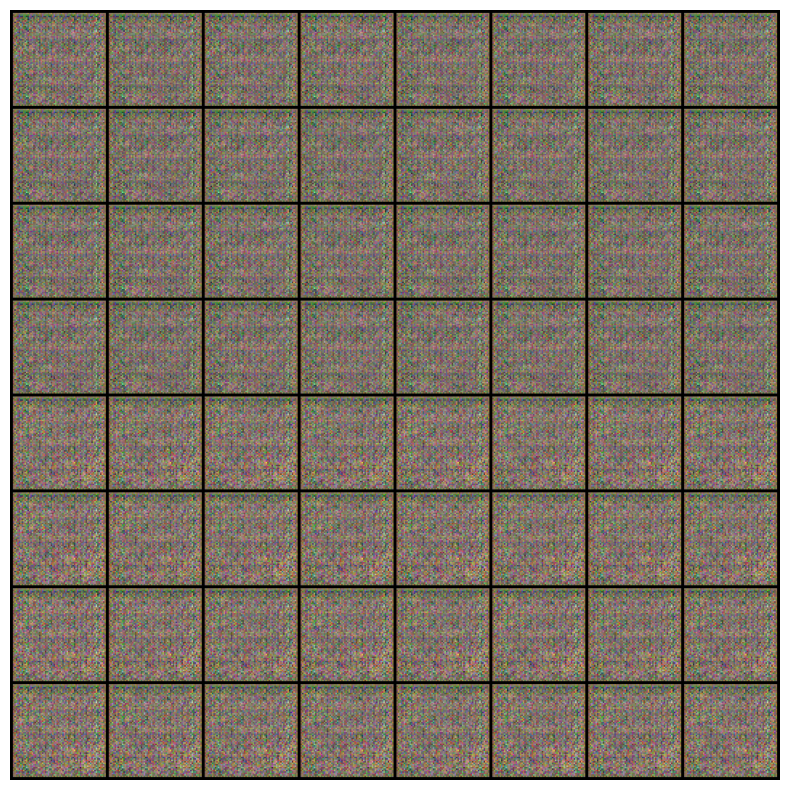

 10%|█         | 1/10 [01:32<13:53, 92.63s/it]

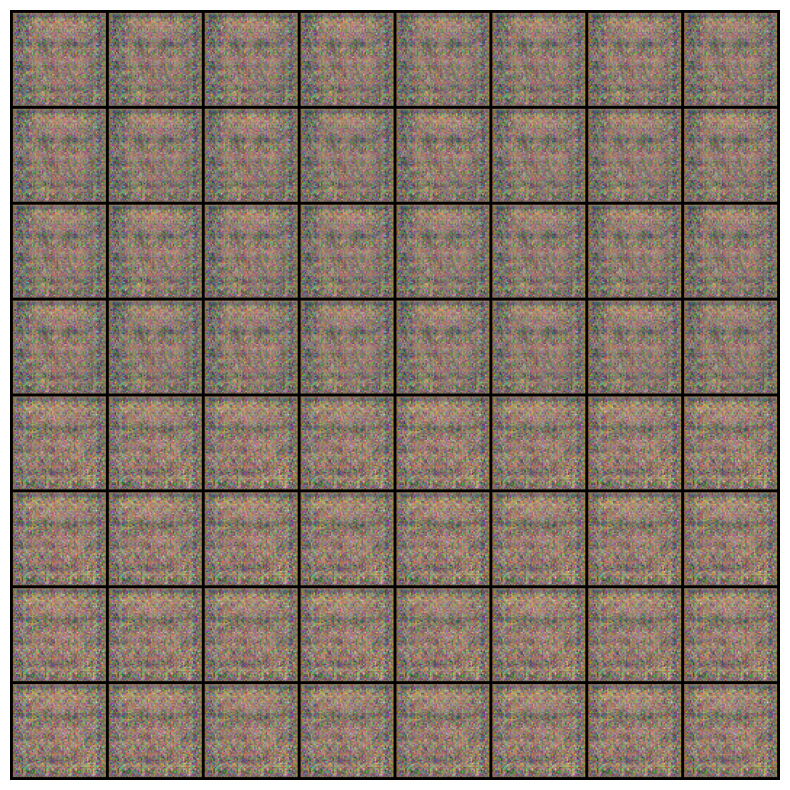

 20%|██        | 2/10 [03:03<12:14, 91.80s/it]

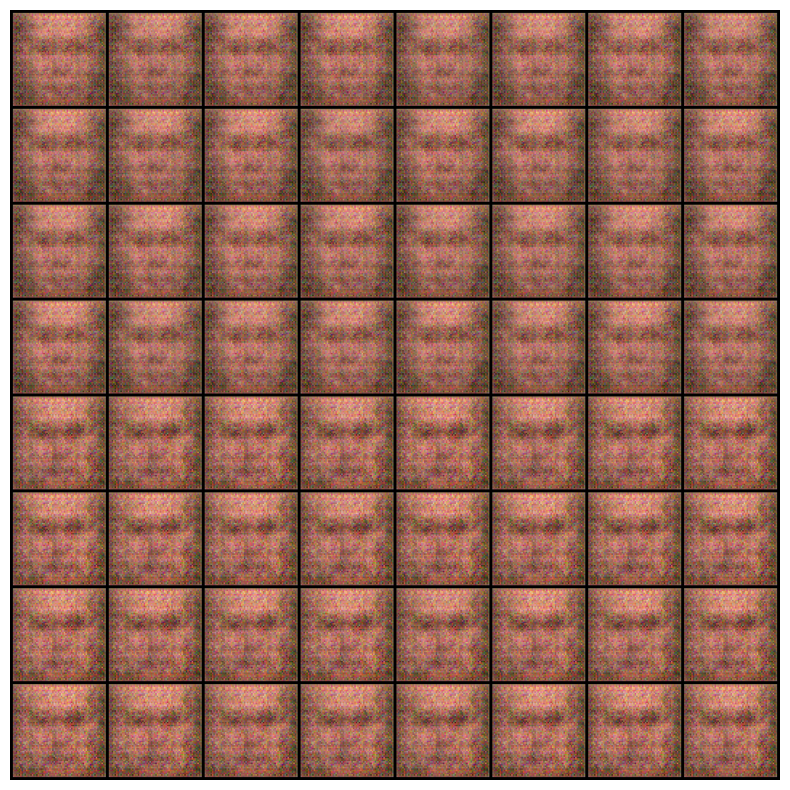

 30%|███       | 3/10 [04:53<11:38, 99.81s/it]

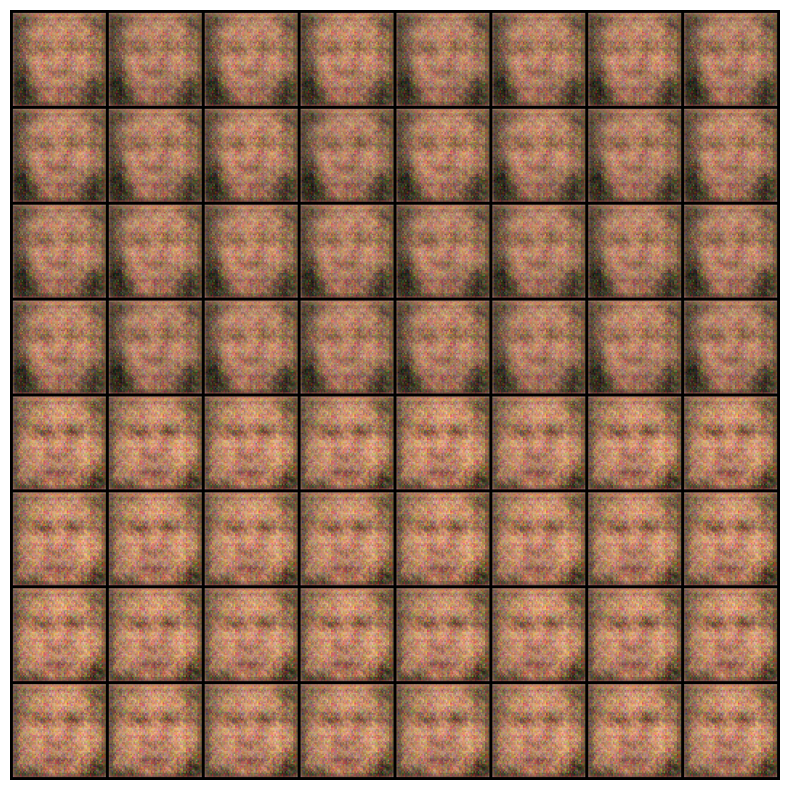

 40%|████      | 4/10 [06:27<09:45, 97.51s/it]

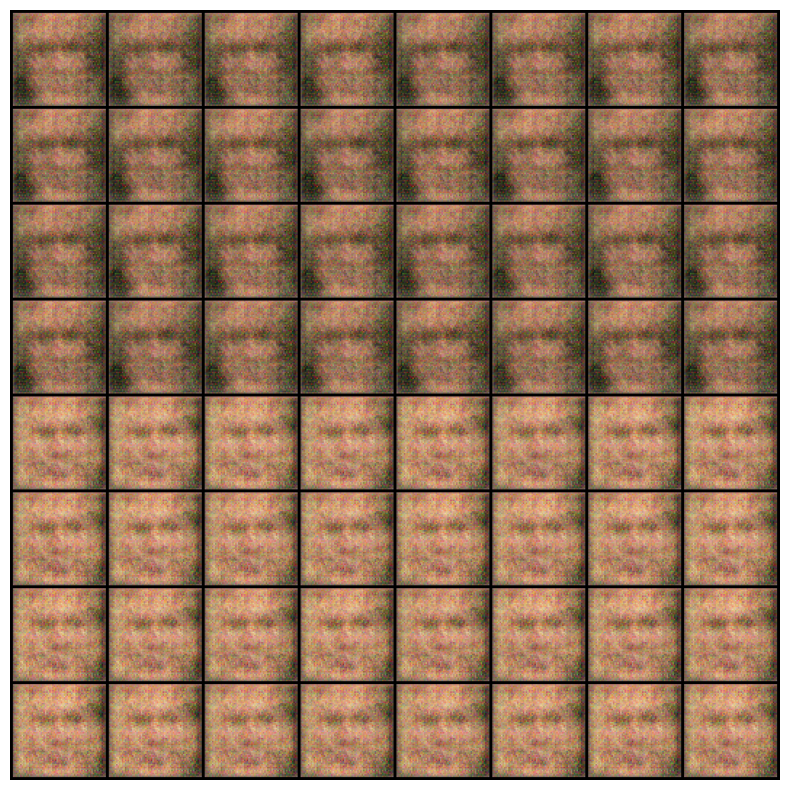

 50%|█████     | 5/10 [07:38<07:19, 87.98s/it]/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


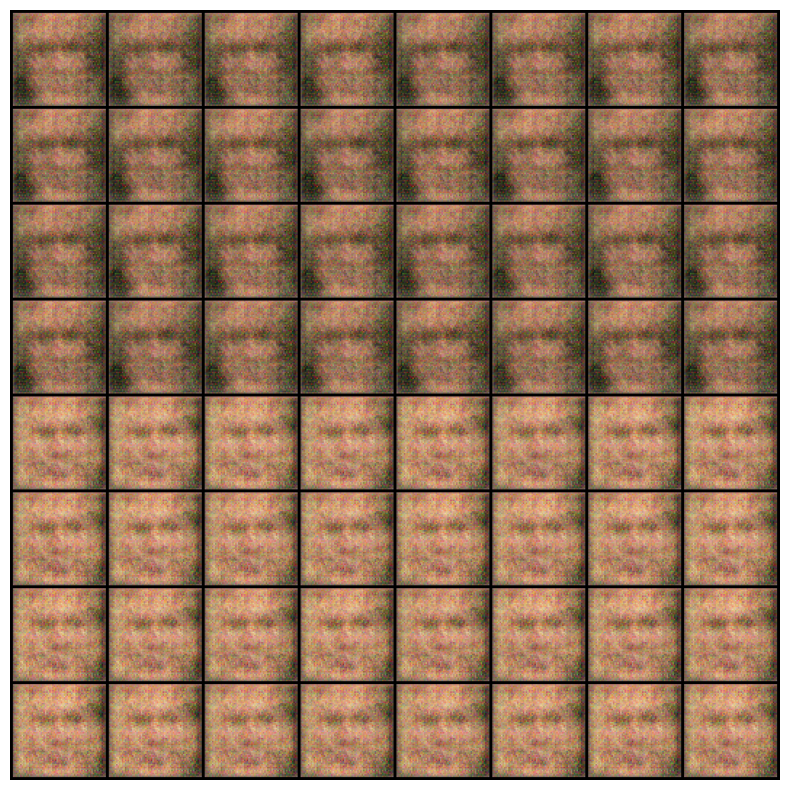

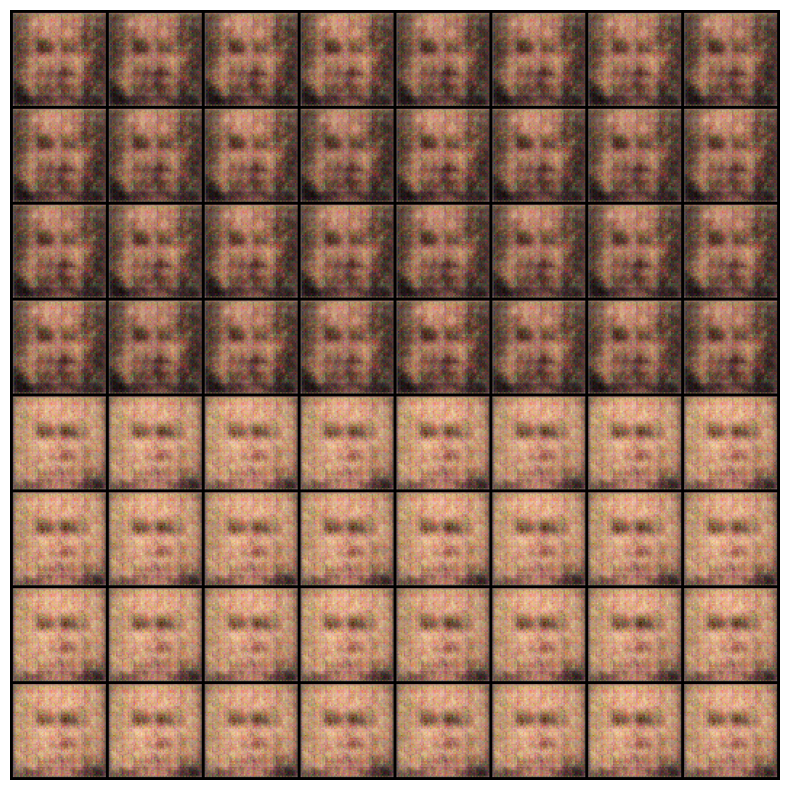

 60%|██████    | 6/10 [08:48<05:27, 81.92s/it]

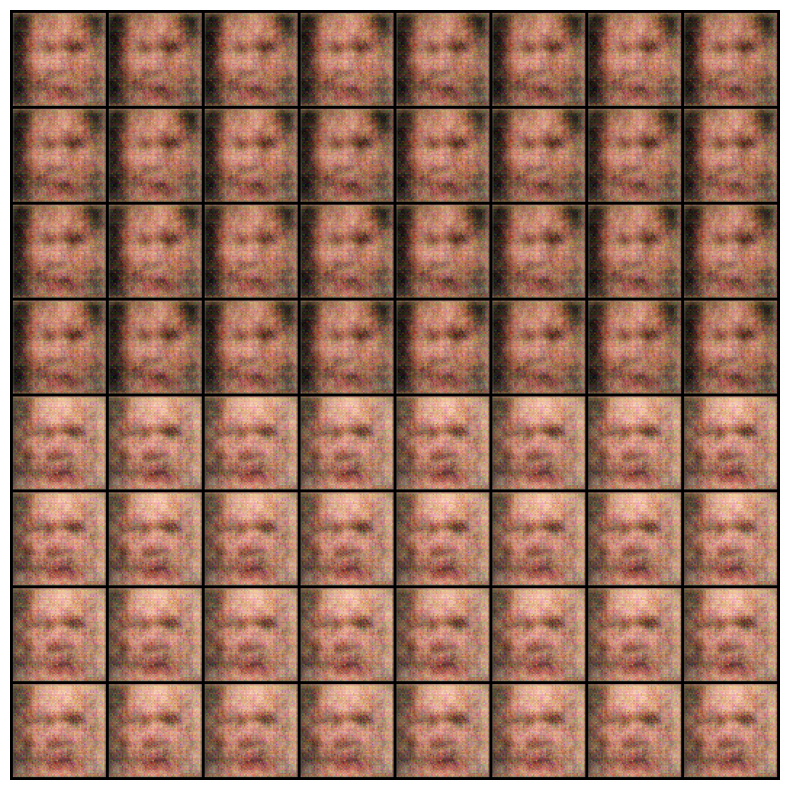

 70%|███████   | 7/10 [10:03<03:58, 79.65s/it]

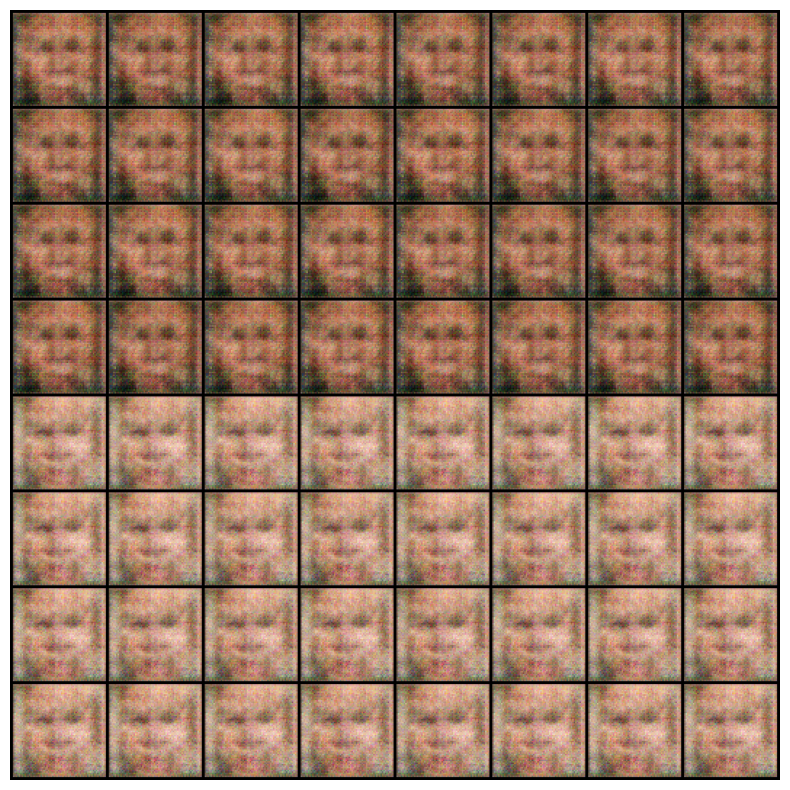

 80%|████████  | 8/10 [11:17<02:35, 77.91s/it]

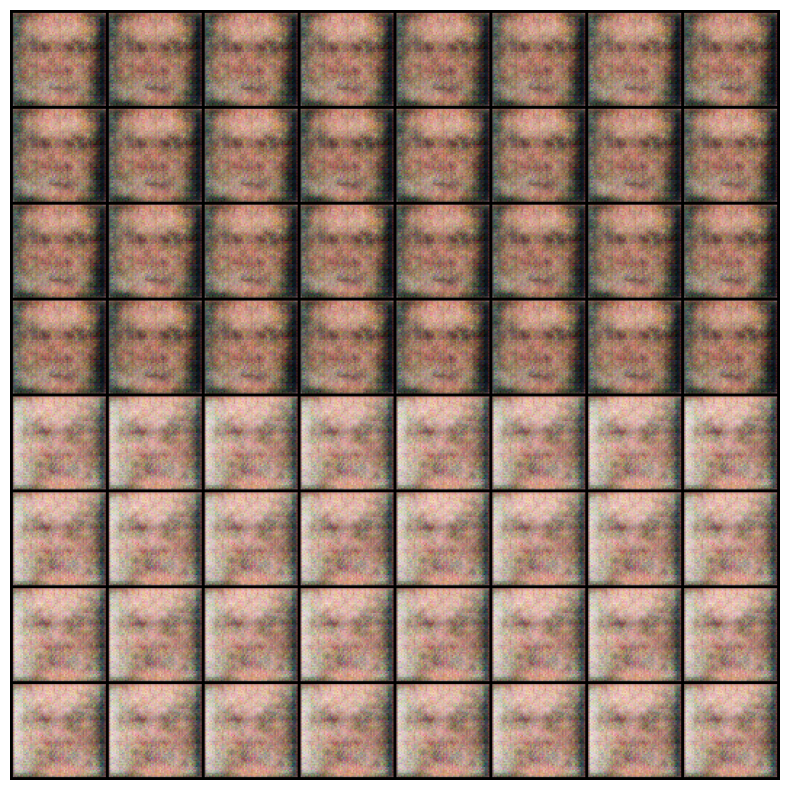

 90%|█████████ | 9/10 [12:51<01:22, 82.83s/it]

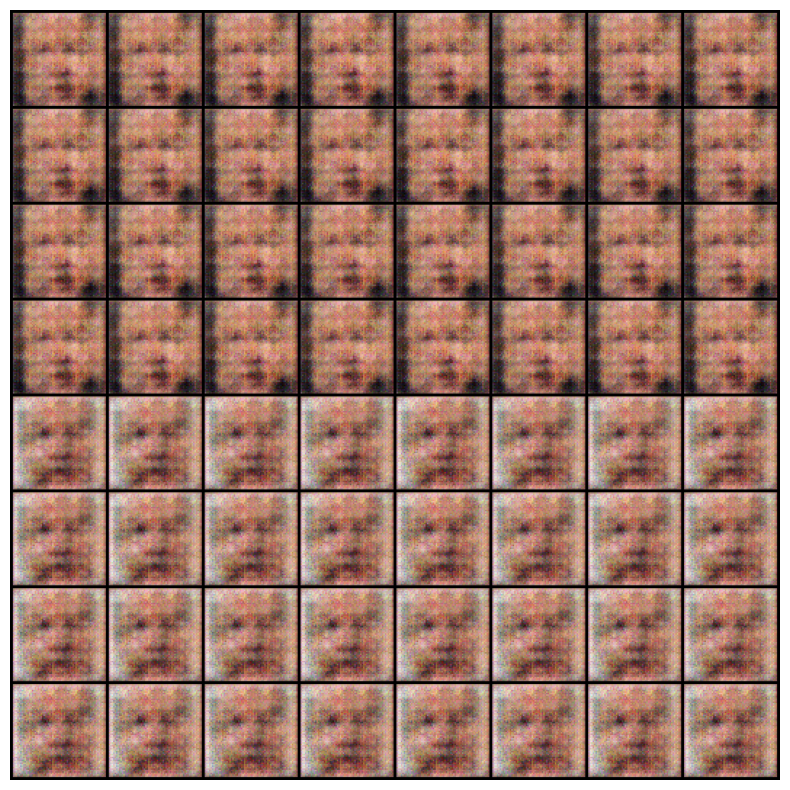

100%|██████████| 10/10 [14:06<00:00, 84.64s/it]


In [28]:
# Code referred from https://wandb.ai/ishandutta/W%26B_Generate_Faces_using_ConditionalGAN/reports/Face-Generation-using-ConditionalGANs--VmlldzozMTcwODY1

n_epochs = 10
for epoch in tqdm(range(n_epochs), total = n_epochs):
    N = len(dataloader)
    for bx, (images, labels) in enumerate(dataloader):
        real_data, real_labels = images.to(device), labels.to(device)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels)
        fake_data = fake_data.detach()
        d_loss = discriminator_train_step(real_data, real_labels, fake_data, fake_labels)
        fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_data))).to(device)
        fake_data = generator(noise(len(real_data)), fake_labels).to(device)
        g_loss = generator_train_step(fake_data, fake_labels)

    with torch.no_grad():
        fake = generator(fixed_noise, fixed_fake_labels).detach().cpu()
        imgs = vutils.make_grid(fake, padding=2, normalize=True).permute(1,2,0)
        img_list.append(imgs)
        show(imgs, sz=10)

    if epoch == 4:
      plt.figure(figsize=(10,10))
      plt.axis("off")
      plt.imshow(imgs)
      plt.savefig("conditional_gan_predictions.jpg")

**The results from this Conditional GAN are not great because I have taken the dataset to be very small i.e. the conditional folders just have 530 and 236 images respectively which is a very small dataset to train a conditional GAN. Therfore the results are not good also the number of epochs that I have taken are small due to large computation time and non-availability of GPU. This better GPU I might have been able to get better results since we can see that the images do tend to converge to a proper face image as compared to the noise that we started with in the first epoch.**

References :

1. https://keras.io/examples/vision/siamese_network/#:~:text=Our%20Siamese%20Network%20will%20generate,learn%20to%20separate%20these%20embeddings.
2. https://www.kaggle.com/code/stoicstatic/face-recognition-siamese-w-triplet-loss
3. https://github.com/rohanrao619/Face_Recognition_using_Siamese_Network/tree/master
4. https://github.com/Jin-Linhao/Siamese_lfw_pytorch
5. https://wandb.ai/ishandutta/W%26B_Generate_Faces_using_ConditionalGAN/reports/Face-Generation-using-ConditionalGANs--VmlldzozMTcwODY1
6. ChatGPT